In [61]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
#import plotly.graph_objs as go
#load da base
from sklearn.datasets import load_boston
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from pandas_profiling import ProfileReport
from math import sqrt
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go
%matplotlib widget

c:\users\rapha\anaconda3\lib\site-packages\sklearn\ensemble\weight_boosting.py:29: DeprecationWarning:

numpy.core.umath_tests is an internal NumPy module and should not be imported. It will be removed in a future NumPy release.



In [2]:
print(np.__version__)

1.19.2


### Este projeto tem como objetivo preve o valor dos imóveis do dataset de boston nativo do sklearn.

In [3]:
boston = load_boston()

data = pd.DataFrame(boston.data, columns=boston.feature_names)
data['MEDV'] = boston.target

data.head()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,MEDV
0,0.00632,18.0,2.31,0.0,0.538,6.575,65.2,4.0900,1.0,296.0,15.3,396.90,4.98,24.0
1,0.02731,0.0,7.07,0.0,0.469,6.421,78.9,4.9671,2.0,242.0,17.8,396.90,9.14,21.6
2,0.02729,0.0,7.07,0.0,0.469,7.185,61.1,4.9671,2.0,242.0,17.8,392.83,4.03,34.7
3,0.03237,0.0,2.18,0.0,0.458,6.998,45.8,6.0622,3.0,222.0,18.7,394.63,2.94,33.4
4,0.06905,0.0,2.18,0.0,0.458,7.147,54.2,6.0622,3.0,222.0,18.7,396.90,5.33,36.2


In [3]:
data.describe()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,MEDV
count,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000
mean,3.593761,11.363636,11.136779,0.069170,0.554695,6.284634,68.574901,3.795043,9.549407,408.237154,18.455534,356.674032,12.653063,22.532806
std,8.596783,23.322453,6.860353,0.253994,0.115878,0.702617,28.148861,2.105710,8.707259,168.537116,2.164946,91.294864,7.141062,9.197104
min,0.006320,0.000000,0.460000,0.000000,0.385000,3.561000,2.900000,1.129600,1.000000,187.000000,12.600000,0.320000,1.730000,5.000000
25%,0.082045,0.000000,5.190000,0.000000,0.449000,5.885500,45.025000,2.100175,4.000000,279.000000,17.400000,375.377500,6.950000,17.025000
50%,0.256510,0.000000,9.690000,0.000000,0.538000,6.208500,77.500000,3.207450,5.000000,330.000000,19.050000,391.440000,11.360000,21.200000
75%,3.647423,12.500000,18.100000,0.000000,0.624000,6.623500,94.075000,5.188425,24.000000,666.000000,20.200000,396.225000,16.955000,25.000000
max,88.976200,100.000000,27.740000,1.000000,0.871000,8.780000,100.000000,12.126500,24.000000,711.000000,22.000000,396.900000,37.970000,50.000000


#### Entendendo as variáveis

**`CRIM`**: Taxa de criminalidade per capita por regiao.

**`ZN`**: Proporção de terrenos residenciais divididos por lotes com mais de 25.000 pés quadrados.

**`INDUS`**: Essa é a proporção de hectares de negócios não comerciais por regiao.

**`CHAS`**: variável fictícia Charles River (= 1 se o trecho limita o rio; 0 caso contrário)

**`NOX`**: concentração de óxido nítrico (partes por 10 milhões)

**`RM`**: Número médio de quartos entre as casas do bairro

**`Age`**: proporção de unidades ocupadas pelos proprietários construídas antes de 1940

**`DIS`**: distâncias ponderadas para cinco centros de emprego em Boston

**`RAD`**: Índice de acessibilidade às rodovias radiais

**`IMPOSTO`**: taxa do imposto sobre a propriedade de valor total por US $ 10.000

**`B`**: 1000 (Bk - 0,63) ², onde Bk é a proporção de pessoas de descendência afro-americana por regiao

**`PTRATIO`**: Bairros com maior proporção de alunos para professores (maior valor de 'PTRATIO')

**`LSTAT`**: porcentagem de status mais baixo da população

**`MEDV`**: valor médio de casas ocupadas pelos proprietários em US $ 1000

#### Análise Exploratório automatizada com pandas profile

In [4]:
profile = ProfileReport(data, title = 'report',html={'style':{'full_width':True}})

In [5]:
profile

In [7]:
profile.to_file("relatório.html")

<AxesSubplot:>

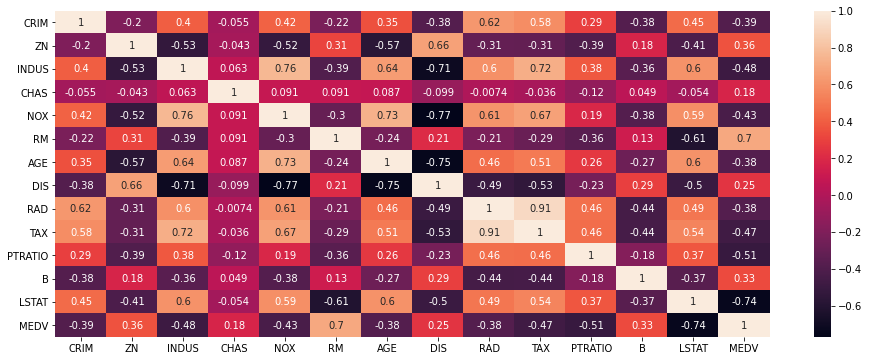

In [4]:
correlacoes = data.corr()

plt.figure(figsize=(16,6))
sns.heatmap(data=correlacoes, annot=True)

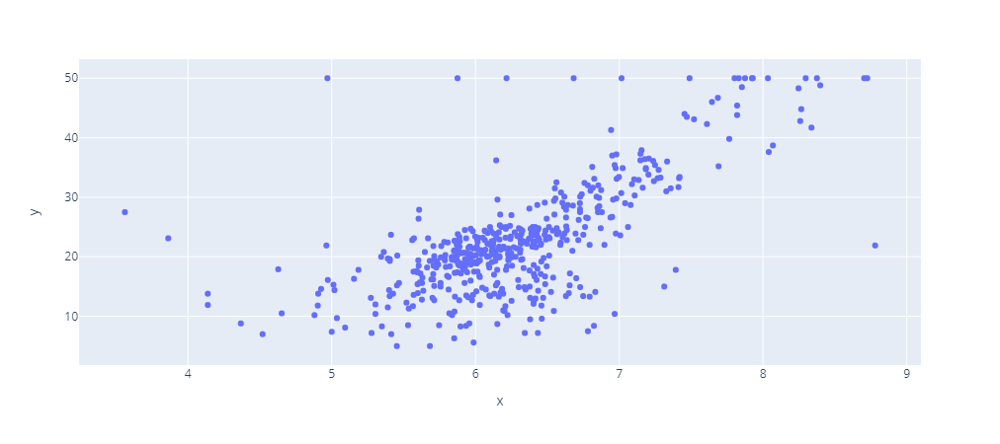

In [5]:
#Correlação positiva
fig = px.scatter(x=data.RM, y=data.MEDV)
fig.show()

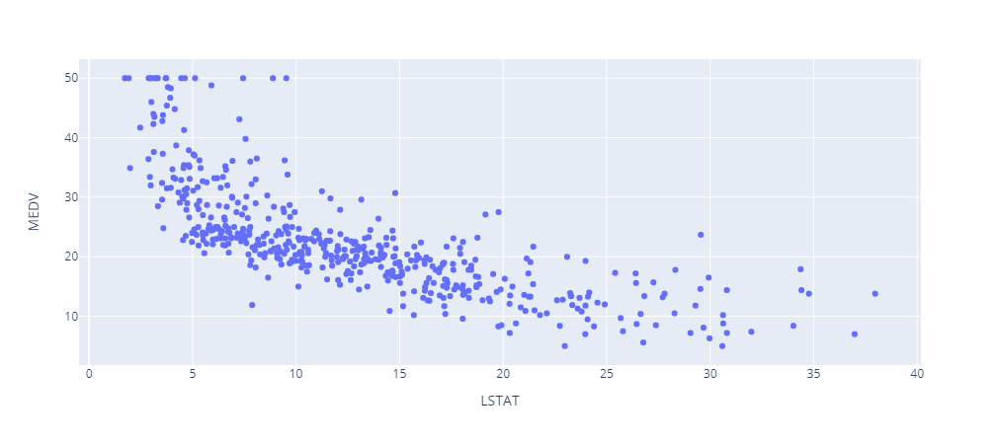

In [6]:
#Correlação negativa
fig = px.scatter(data, x=data.LSTAT, y=data.MEDV)
fig.show()

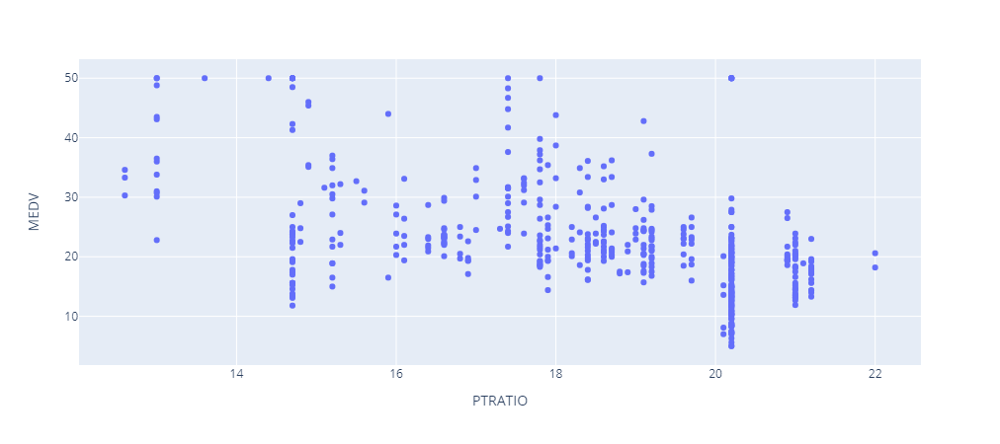

In [7]:
#Sem correlação
fig = px.scatter(data, x=data.PTRATIO, y=data.MEDV)
fig.show()

# Analisando outliers

In [8]:
#estatística descritiva

data.RM.describe()

count    506.000000
mean       6.284634
std        0.702617
min        3.561000
25%        5.885500
50%        6.208500
75%        6.623500
max        8.780000
Name: RM, dtype: float64

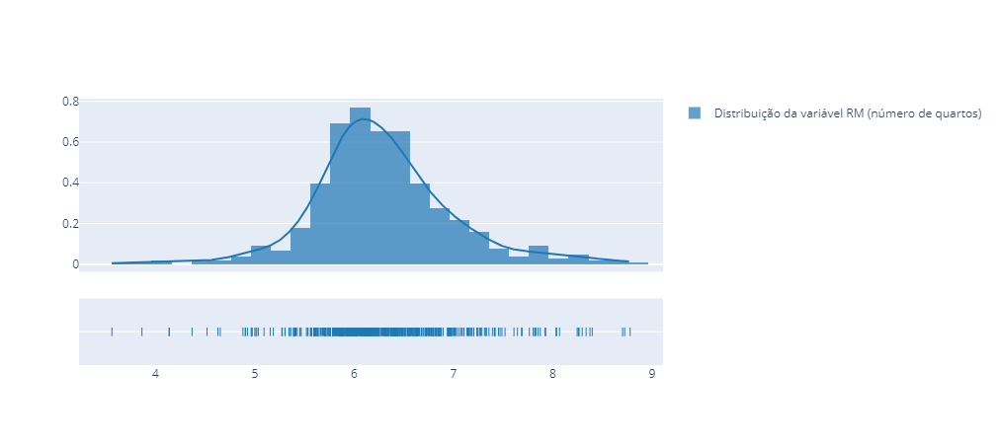

In [10]:
#Visualizando a distribuição da variável RM
labels = ['Distribuição da variável RM (número de quartos)']
fig = ff.create_distplot([data.RM], labels, bin_size=.2)
fig.show()

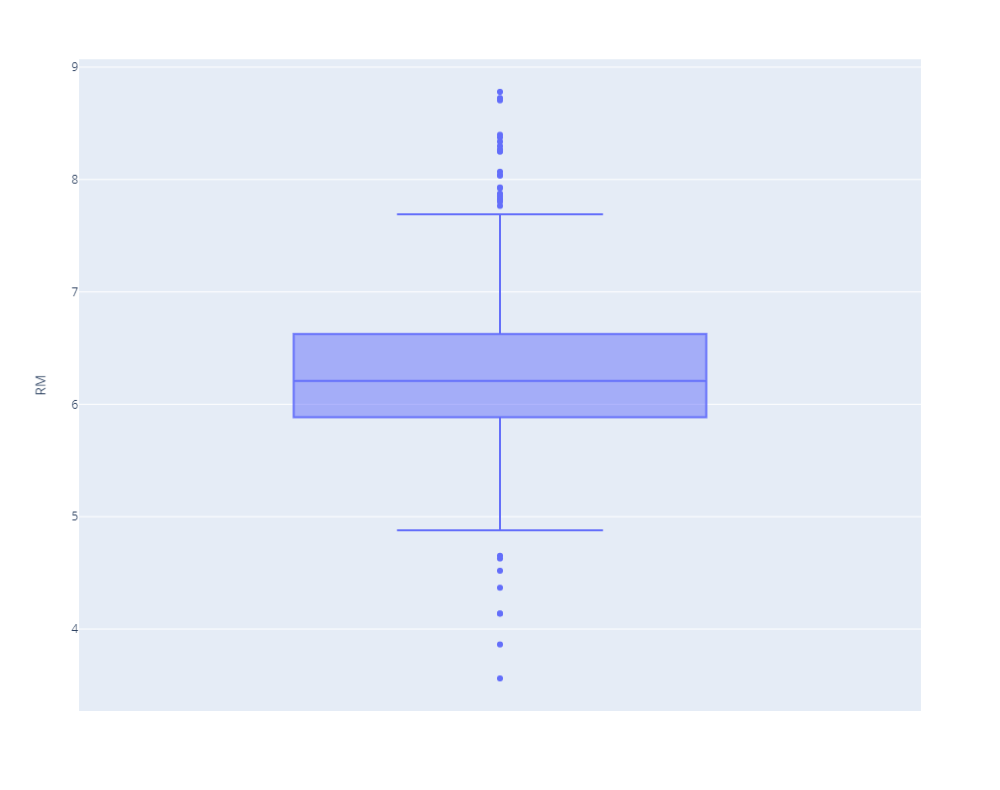

In [11]:
#Visualizando outliers da variável RM

fig = px.box(data, y='RM')
fig.update_layout(width=800, height=800)
fig.show()

#Acima do limite superior ou abaixo do limite inferior, são outliers

In [12]:
data.MEDV.describe()

count    506.000000
mean      22.532806
std        9.197104
min        5.000000
25%       17.025000
50%       21.200000
75%       25.000000
max       50.000000
Name: MEDV, dtype: float64

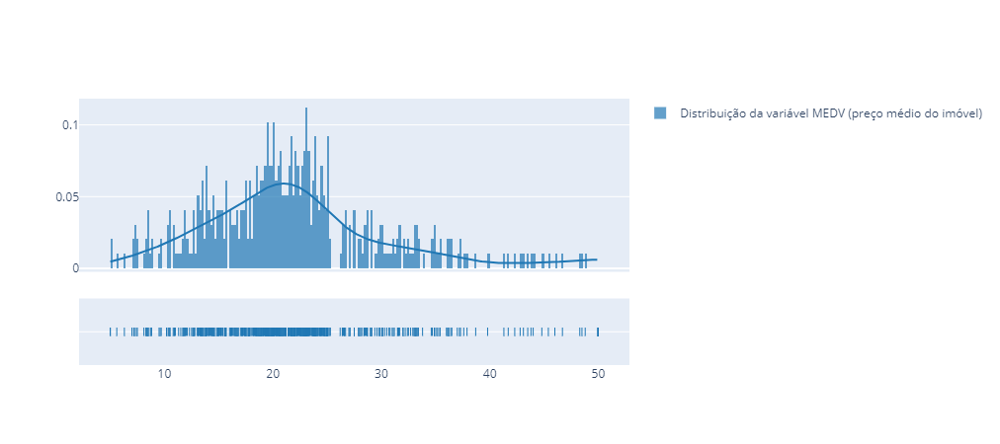

In [13]:
#Visualizando a distribuição da variável RM
labels = ['Distribuição da variável MEDV (preço médio do imóvel)']
fig = ff.create_distplot([data.MEDV], labels, bin_size=.2)
fig.show()
#Variável com simetria positiva (cauda longa à direta) - (media > mediana > moda)

In [15]:
# Analisando a simetria da viarável
stats.skew(data.MEDV)

1.104810822864635

Coeficiente de Pearson

    Valor entre -1 e 1 - distribuição simétrica
    
    Valor maior que 1 - distribuição assimétrica positiva
    
    Valor maior que -1 - distribuição assimétrica negativa

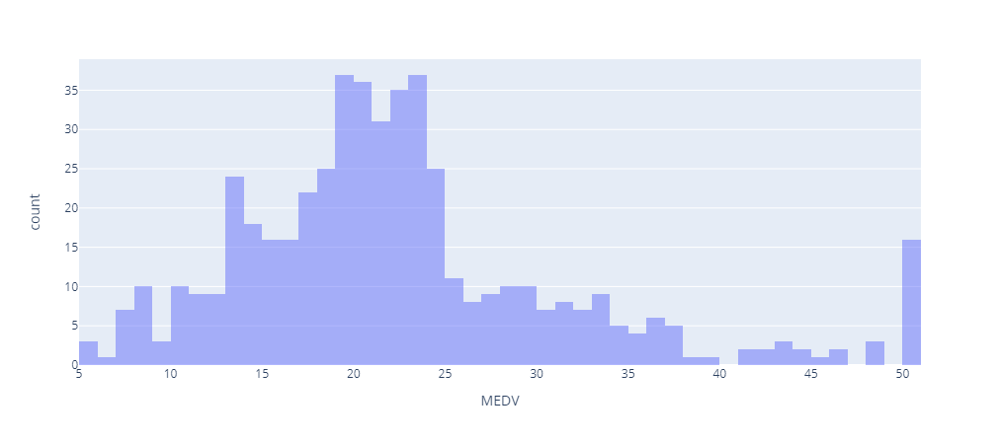

In [16]:
# Histograma da variável alvo
fig = px.histogram(data, x="MEDV", nbins=50, opacity=0.5)
fig.show()

Aqui fica claro que temos alguns pontos de outliers (16 pontos) na nossa variável alvo. Precisamos definir um procedimento para lidar com eles

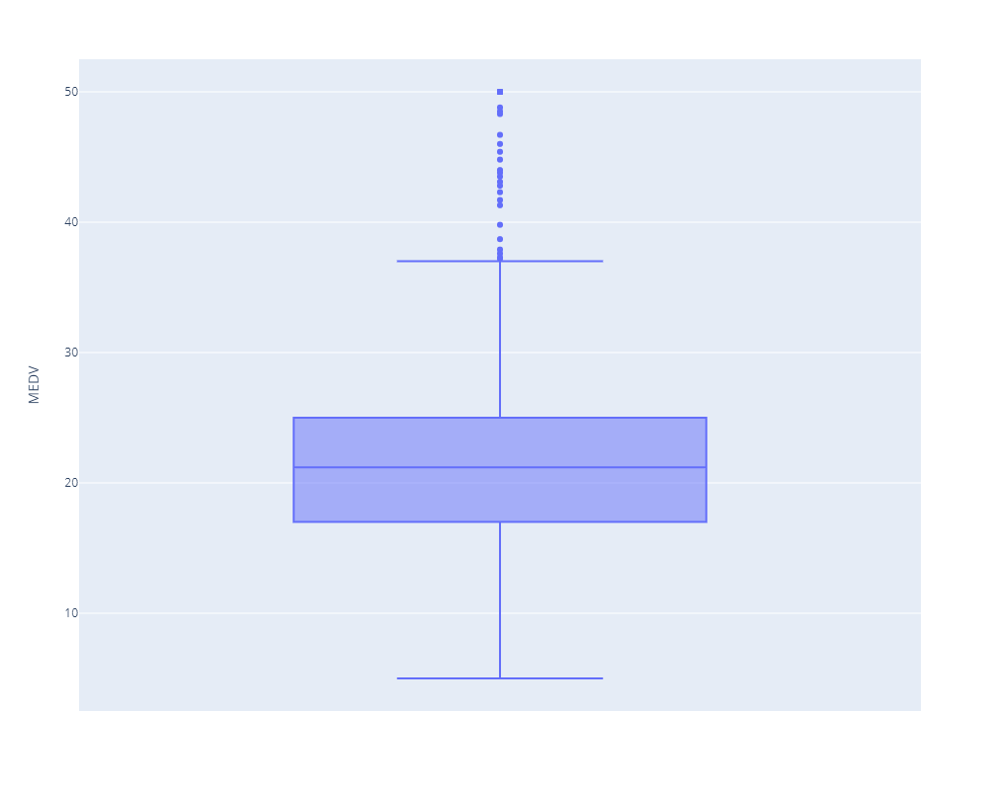

In [17]:
#Visualizando outliers da variável MEDV

fig = px.box(data, y='MEDV')
fig.update_layout(width=800, height=800)
fig.show()

#Acima do limite superior ou abaixo do limite inferior, são outliers

In [19]:
# inspecionando variávels para tomar decisões sobre os outliers

data[['PTRATIO','LSTAT','RM']].describe()

,PTRATIO,LSTAT,RM
count,506.000000,506.000000,506.000000
mean,18.455534,12.653063,6.284634
std,2.164946,7.141062,0.702617
min,12.600000,1.730000,3.561000
25%,17.400000,6.950000,5.885500
50%,19.050000,11.360000,6.208500
75%,20.200000,16.955000,6.623500
max,22.000000,37.970000,8.780000


In [20]:
# imprimindo oos 16 maiores valores de MEDV

data[['PTRATIO','LSTAT','RM','MEDV']].nlargest(16, 'MEDV')

,PTRATIO,LSTAT,RM,MEDV
161,14.7,1.73,7.489,50.0
162,14.7,1.92,7.802,50.0
163,14.7,3.32,8.375,50.0
166,14.7,3.70,7.929,50.0
186,17.8,4.45,7.831,50.0
195,14.4,2.97,7.875,50.0
204,14.7,2.88,8.034,50.0
225,17.4,4.63,8.725,50.0
257,13.0,5.12,8.704,50.0
267,13.0,7.44,8.297,50.0


Observa-se um comportamento estranho nos dados e opta-se por excluir estes 16 registros, diminuindo assim a assimetria da distribuição

In [4]:
top16 = data.nlargest(16, 'MEDV').index

In [5]:
data.drop(top16, inplace=True)

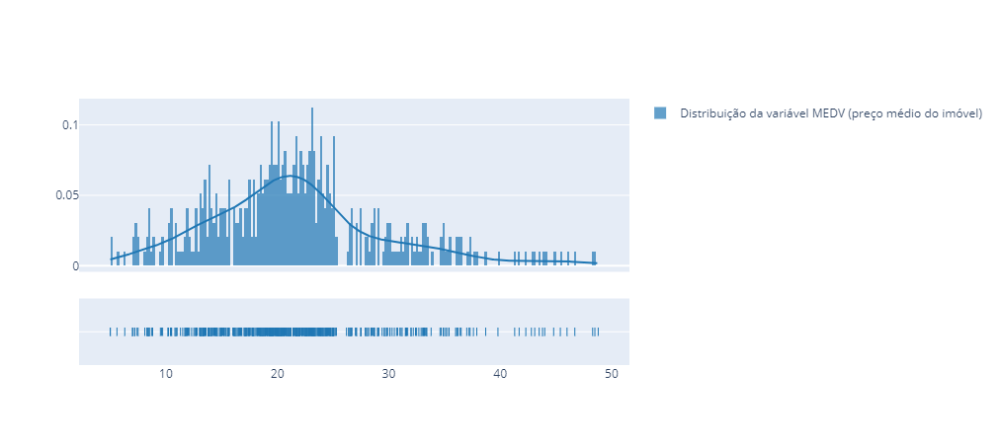

In [23]:
#Visualizando a distribuição da variável RM
labels = ['Distribuição da variável MEDV (preço médio do imóvel)']
fig = ff.create_distplot([data.MEDV], labels, bin_size=.2)
fig.show()
#Variável com simetria positiva (cauda longa à direta) - (media > mediana > moda)

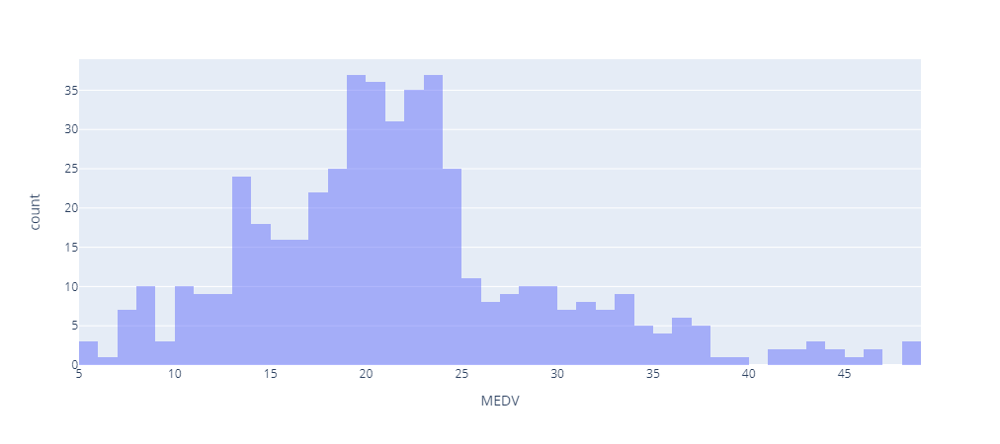

In [24]:
# Histograma da variável alvo
fig = px.histogram(data, x="MEDV", nbins=50, opacity=0.5)
fig.show()

In [6]:
# Analisando a simetria da viarável
stats.skew(data.MEDV)

0.7732836030909053

Ainda é possível identificar a assimetria, mas de uma forma mais suave. Sendo assim, temos mais chances de construir um modelo mais assertivo sem eles

### Definindo um baseline

É importante para ter marcos no projeto

Permite uma explicação fácil para todos os envolvidos

É algo que sempre tentaremos ganhar na medida do possível

In [7]:
# Convertendo os dados
data.RM = data.RM.astype(int)

In [8]:
# definindo uma lista de categória dos imóveis baseado no número de quartos

categorias = []

for i in data.RM.iteritems():
    valor = (i[1])
    if valor <=4:
        categorias.append('Pequeno')
    elif valor < 7:
        categorias.append('Médio')
    else:
        categorias.append('Grande')
        
data['categorias'] = categorias

In [9]:
data.categorias.value_counts()

Médio      424
Grande      52
Pequeno     14
Name: categorias, dtype: int64

In [10]:
# Agrupa as categorias e calculas as médias dos valores dos imóveis

medias_categorias = data.groupby(by='categorias')['MEDV'].mean()
medias_categorias

categorias
Grande     35.719231
Médio      20.130425
Pequeno    14.921429
Name: MEDV, dtype: float64

In [11]:
# criando o dicionário do baseline
dic_baseline = {'Grande': medias_categorias[0], 'Médio': medias_categorias[1], 'Pequeno': medias_categorias[2]}
dic_baseline

{'Grande': 35.71923076923077,
 'Médio': 20.1304245283019,
 'Pequeno': 14.921428571428574}

In [12]:
#Criando a função do baseline
def retorna_baseline(num_quartos):

    if num_quartos <=4:
        return dic_baseline.get('Pequeno')
    elif num_quartos < 7:
        return dic_baseline.get('Médio')
    else:
        return dic_baseline.get('Grande')

In [13]:
#Testando a função
for i in data.RM.iteritems():
    n_quartos = i[1]
    print('Número de quartos é: {}, valor médio: {}'.format(n_quartos, retorna_baseline(n_quartos)))

Número de quartos é: 6, valor médio: 20.1304245283019
Número de quartos é: 6, valor médio: 20.1304245283019
Número de quartos é: 7, valor médio: 35.71923076923077
Número de quartos é: 6, valor médio: 20.1304245283019
Número de quartos é: 7, valor médio: 35.71923076923077
Número de quartos é: 6, valor médio: 20.1304245283019
Número de quartos é: 6, valor médio: 20.1304245283019
Número de quartos é: 6, valor médio: 20.1304245283019
Número de quartos é: 5, valor médio: 20.1304245283019
Número de quartos é: 6, valor médio: 20.1304245283019
Número de quartos é: 6, valor médio: 20.1304245283019
Número de quartos é: 6, valor médio: 20.1304245283019
Número de quartos é: 5, valor médio: 20.1304245283019
Número de quartos é: 5, valor médio: 20.1304245283019
Número de quartos é: 6, valor médio: 20.1304245283019
Número de quartos é: 5, valor médio: 20.1304245283019
Número de quartos é: 5, valor médio: 20.1304245283019
Número de quartos é: 5, valor médio: 20.1304245283019
Número de quartos é: 5, va

In [14]:
data.head()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,MEDV,categorias
0,0.00632,18.0,2.31,0.0,0.538,6,65.2,4.0900,1.0,296.0,15.3,396.90,4.98,24.0,Médio
1,0.02731,0.0,7.07,0.0,0.469,6,78.9,4.9671,2.0,242.0,17.8,396.90,9.14,21.6,Médio
2,0.02729,0.0,7.07,0.0,0.469,7,61.1,4.9671,2.0,242.0,17.8,392.83,4.03,34.7,Grande
3,0.03237,0.0,2.18,0.0,0.458,6,45.8,6.0622,3.0,222.0,18.7,394.63,2.94,33.4,Médio
4,0.06905,0.0,2.18,0.0,0.458,7,54.2,6.0622,3.0,222.0,18.7,396.90,5.33,36.2,Grande


Prepadando os dados para o modelo

In [15]:
#removendo as colunas dispensáveis ao modelo 
X = data.drop(['RAD','TAX','MEDV','DIS','AGE','ZN','categorias'], axis=1)

In [16]:
Y = data['MEDV']

In [18]:
X.head()

,CRIM,INDUS,CHAS,NOX,RM,PTRATIO,B,LSTAT
0,0.00632,2.31,0.0,0.538,6,15.3,396.90,4.98
1,0.02731,7.07,0.0,0.469,6,17.8,396.90,9.14
2,0.02729,7.07,0.0,0.469,7,17.8,392.83,4.03
3,0.03237,2.18,0.0,0.458,6,18.7,394.63,2.94
4,0.06905,2.18,0.0,0.458,7,18.7,396.90,5.33


In [19]:
X_train, X_test, Y_train, Y_test = train_test_split(X,Y, test_size = 0.2, random_state=5)

In [21]:
X_train.shape, X_test.shape, Y_train.shape, Y_test.shape

((392, 8), (98, 8), (392,), (98,))

In [22]:
#definindo uma estrutra para organizar as predições
predicoes = []

# Para cada elemento do teste, alimenta a lista de predições
for i in X_test.RM.iteritems():
    n_quartos = i[1]
    predicoes.append(retorna_baseline(n_quartos))

predicoes[:10]

[20.1304245283019,
 20.1304245283019,
 20.1304245283019,
 20.1304245283019,
 20.1304245283019,
 20.1304245283019,
 20.1304245283019,
 20.1304245283019,
 35.71923076923077,
 35.71923076923077]

In [24]:
# Mantendo um log do projeto para avaliarmos a evolução do baseline

df_result = pd.DataFrame()

df_result['valor_real'] = Y_test.values
df_result['valor_predito_baseline'] = predicoes

df_result.head()

,valor_real,valor_predito_baseline
0,18.5,20.130425
1,12.7,20.130425
2,21.4,20.130425
3,23.7,20.130425
4,20.8,20.130425


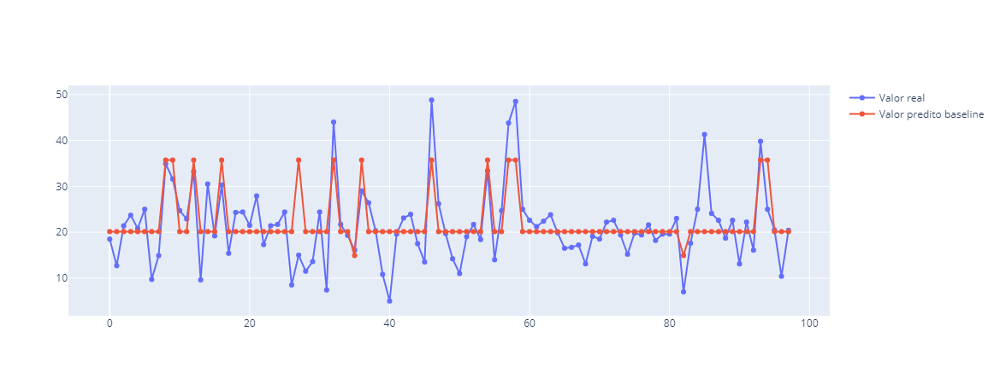

In [27]:
# plotando o valor real e o baseline

#Create traces
fig = go.Figure()

#dados de teste
fig.add_trace(go.Scatter(x=df_result.index,
                         y=df_result.valor_real, 
                         mode='lines+markers', 
                         name='Valor real'))

# dados preditos
fig.add_trace(go.Scatter(x=df_result.index,
                         y=df_result.valor_predito_baseline, 
                         mode='lines+markers', 
                         name='Valor predito baseline'))

fig.show()

In [36]:
# Avaliação do modelo de baseline por métricas (Erro médio quadrático (RMSE))
# Somatório das diferenças entre os valores preditos e os valores reais
# mantém a mesma unidade independete

rmse = np.sqrt(mean_squared_error(Y_test, predicoes))

rmse

6.205816494411828

In [40]:
# Regressão linear

lr = LinearRegression()
lr.fit(X_train, Y_train)
y_pred_lr = lr.predict(X_test)

rmse = np.sqrt(mean_squared_error(Y_test, y_pred_lr))
rmse

4.4600616197667105

In [42]:
df_result['valor_predito_lr'] = y_pred_lr

df_result.head()

,valor_real,valor_predito_baseline,valor_predito_lr
0,18.5,20.130425,18.458476
1,12.7,20.130425,12.251824
2,21.4,20.130425,24.590261
3,23.7,20.130425,28.256681
4,20.8,20.130425,18.194080


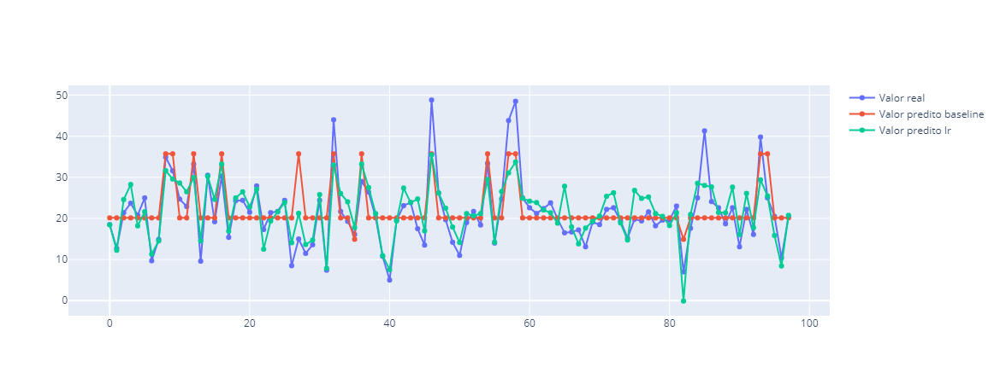

In [46]:
# plotando o valor real e o baseline

#Create traces
fig = go.Figure()

#dados de teste
fig.add_trace(go.Scatter(x=df_result.index,
                         y=df_result.valor_real, 
                         mode='lines+markers', 
                         name='Valor real'))

# dados preditos baseline
fig.add_trace(go.Scatter(x=df_result.index,
                         y=df_result.valor_predito_baseline, 
                         mode='lines+markers', 
                         name='Valor predito baseline'))

# dados preditos regressão linear
fig.add_trace(go.Scatter(x=df_result.index,
                         y=df_result.valor_predito_lr, 
                         mode='lines+markers',
                         #line = dict(color = '#FEBFB3'),
                         name='Valor predito lr'))

fig.show()

In [58]:
# Árvore de decisão

dt = DecisionTreeRegressor()
dt.fit(X_train, Y_train)
y_pred_dt = dt.predict(X_test)

rmse = np.sqrt(mean_squared_error(Y_test, y_pred_dt))
rmse

4.292209364009379

In [59]:
df_result['valor_predito_tree'] = y_pred_dt

df_result.head()

,valor_real,valor_predito_baseline,valor_predito_lr,valor_predito_tree
0,18.5,20.130425,18.458476,17.8
1,12.7,20.130425,12.251824,23.2
2,21.4,20.130425,24.590261,24.5
3,23.7,20.130425,28.256681,23.3
4,20.8,20.130425,18.194080,21.8


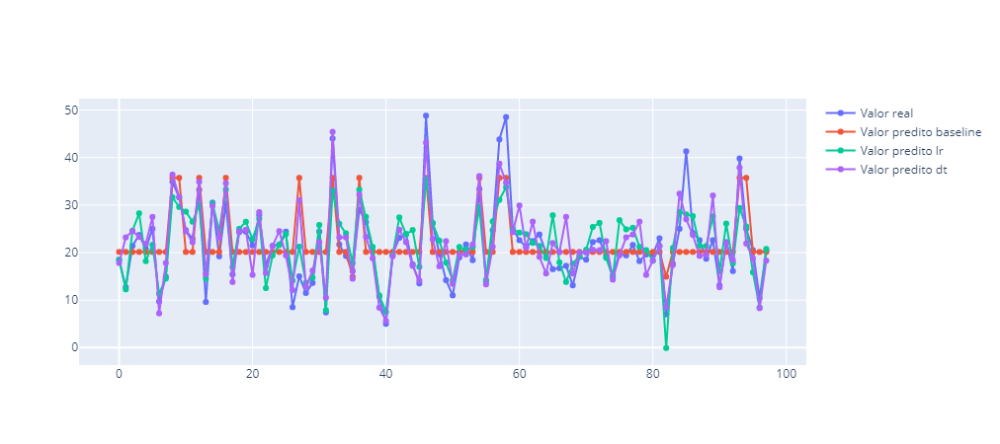

In [60]:
# plotando o valor real e o baseline

#Create traces
fig = go.Figure()

#dados de teste
fig.add_trace(go.Scatter(x=df_result.index,
                         y=df_result.valor_real, 
                         mode='lines+markers', 
                         name='Valor real'))

# dados preditos baseline
fig.add_trace(go.Scatter(x=df_result.index,
                         y=df_result.valor_predito_baseline, 
                         mode='lines+markers', 
                         name='Valor predito baseline'))

# dados preditos regressão linear
fig.add_trace(go.Scatter(x=df_result.index,
                         y=df_result.valor_predito_lr, 
                         mode='lines+markers',
                         #line = dict(color = '#FEBFB3'),
                         name='Valor predito lr'))

# dados preditos regressão linear
fig.add_trace(go.Scatter(x=df_result.index,
                         y=df_result.valor_predito_tree, 
                         mode='lines+markers',
                         #line = dict(color = '#FEBFB3'),
                         name='Valor predito dt'))

fig.show()

In [62]:
rf = RandomForestRegressor()

rf.fit(X_train, Y_train)
y_pred_rf = rf.predict(X_test)

rmse = np.sqrt(mean_squared_error(Y_test, y_pred_rf))
rmse

3.4339683713613613

In [63]:
df_result['valor_predito_forest'] = y_pred_rf

df_result.head()

,valor_real,valor_predito_baseline,valor_predito_lr,valor_predito_tree,valor_predito_forest
0,18.5,20.130425,18.458476,17.8,19.74
1,12.7,20.130425,12.251824,23.2,16.48
2,21.4,20.130425,24.590261,24.5,23.72
3,23.7,20.130425,28.256681,23.3,23.94
4,20.8,20.130425,18.194080,21.8,20.58


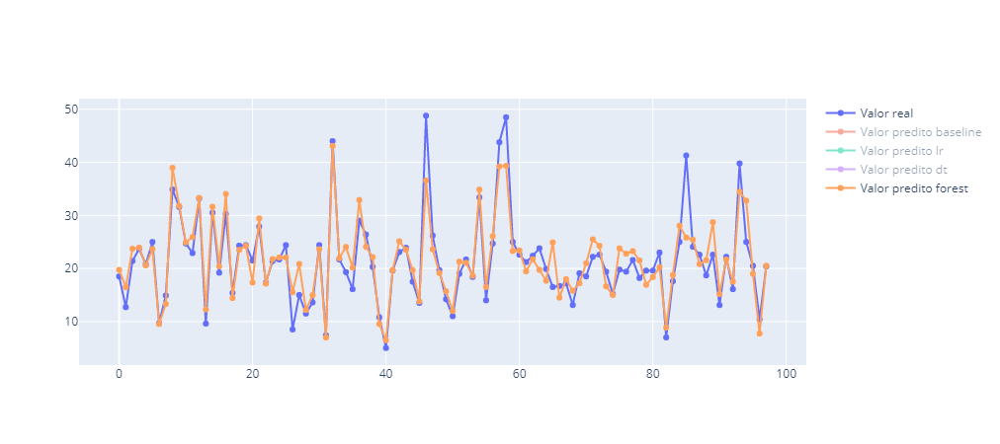

In [64]:
# plotando o valor real e o baseline

#Create traces
fig = go.Figure()

#dados de teste
fig.add_trace(go.Scatter(x=df_result.index,
                         y=df_result.valor_real, 
                         mode='lines+markers', 
                         name='Valor real'))

# dados preditos baseline
fig.add_trace(go.Scatter(x=df_result.index,
                         y=df_result.valor_predito_baseline, 
                         mode='lines+markers', 
                         name='Valor predito baseline'))

# dados preditos regressão linear
fig.add_trace(go.Scatter(x=df_result.index,
                         y=df_result.valor_predito_lr, 
                         mode='lines+markers',
                         #line = dict(color = '#FEBFB3'),
                         name='Valor predito lr'))

# dados preditos árvore de decisão
fig.add_trace(go.Scatter(x=df_result.index,
                         y=df_result.valor_predito_tree, 
                         mode='lines+markers',
                         #line = dict(color = '#FEBFB3'),
                         name='Valor predito dt'))

# dados preditos random forest
fig.add_trace(go.Scatter(x=df_result.index,
                         y=df_result.valor_predito_forest, 
                         mode='lines+markers',
                         #line = dict(color = '#FEBFB3'),
                         name='Valor predito forest'))

fig.show()

In [65]:
# Preprando para o deploy

X['MEDV'] = Y

X.to_csv('data.csv',index=False)

In [66]:
X.head()

,CRIM,INDUS,CHAS,NOX,RM,PTRATIO,B,LSTAT,MEDV
0,0.00632,2.31,0.0,0.538,6,15.3,396.90,4.98,24.0
1,0.02731,7.07,0.0,0.469,6,17.8,396.90,9.14,21.6
2,0.02729,7.07,0.0,0.469,7,17.8,392.83,4.03,34.7
3,0.03237,2.18,0.0,0.458,6,18.7,394.63,2.94,33.4
4,0.06905,2.18,0.0,0.458,7,18.7,396.90,5.33,36.2
